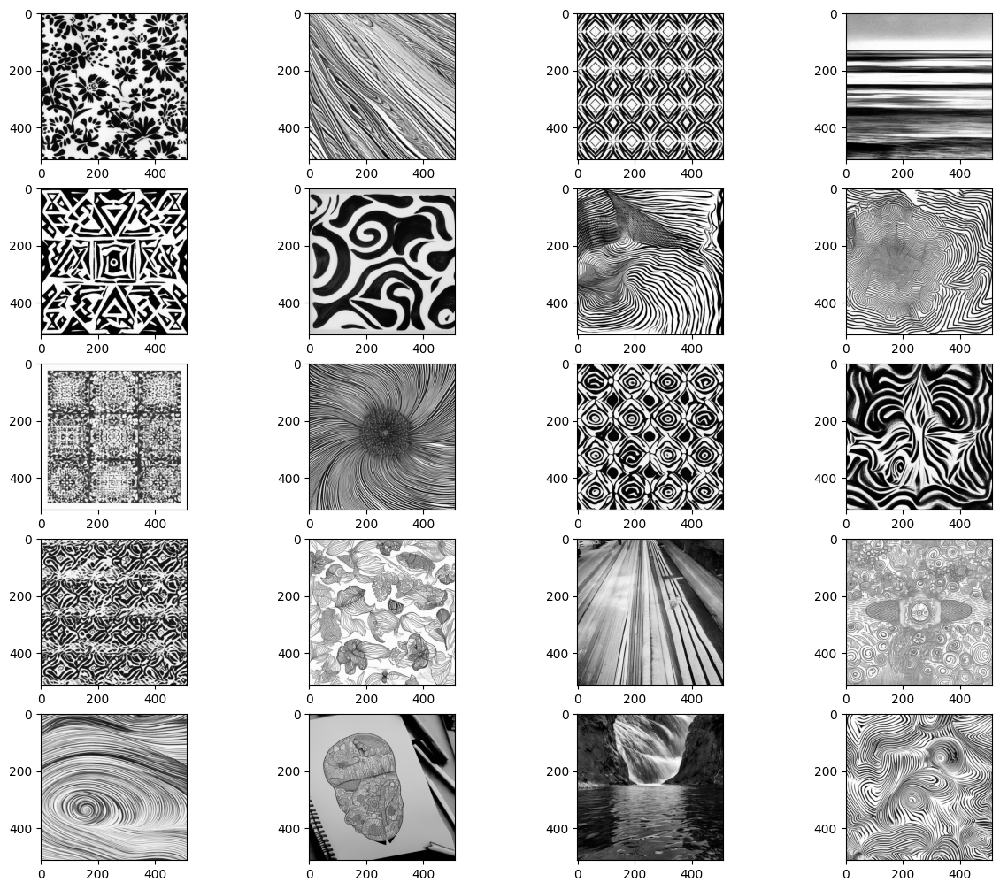

In [17]:
import torch
import torchvision
import matplotlib.pyplot as plt

device = torch.device('cuda')

def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15)) 
    for i, img in enumerate(data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img[0])

data = torchvision.datasets.ImageFolder('./dataset_train')
show_images(data)

In [18]:
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """ 
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """ 
    Takes an image and a timestep as input and 
    returns the noisy version of it
    """        
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

In [19]:
from torchvision import transforms 
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 64
BATCH_SIZE = 128

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1] 
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1] 
    ]
    data_transform = transforms.Compose(data_transforms)
    train = torchvision.datasets.ImageFolder('./dataset_train', transform=data_transform)
    test = torchvision.datasets.ImageFolder('./dataset_test', transform=data_transform)

    return torch.utils.data.ConcatDataset([train, test])

def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :] 
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

C:\Users\Administrator\AppData\Local\Temp\ipykernel_9972\3376888447.py:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


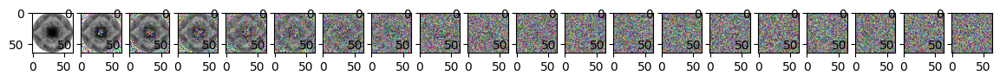

In [20]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 20
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

In [21]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()
        
    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3 
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )
        
        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])
        
        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)           
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor

In [22]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [23]:

@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns 
    the denoised image. 
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    
    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)
    
    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise 

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 20
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()            

Epoch 0 | step 000 Loss: 0.8119465708732605 


C:\Users\Administrator\AppData\Local\Temp\ipykernel_9972\1285582088.py:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


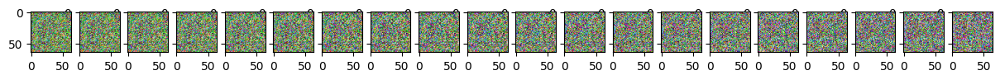

Epoch 5 | step 000 Loss: 0.3256405293941498 


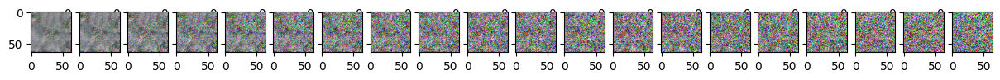

Epoch 10 | step 000 Loss: 0.2804933190345764 


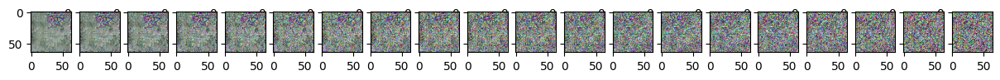

Epoch 15 | step 000 Loss: 0.2834981679916382 


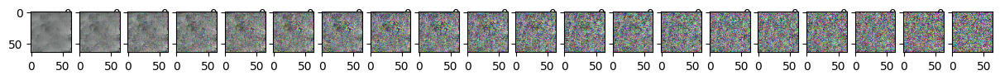

Epoch 20 | step 000 Loss: 0.24862651526927948 


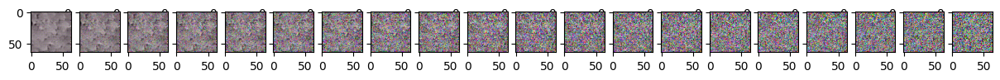

Epoch 25 | step 000 Loss: 0.23663191497325897 


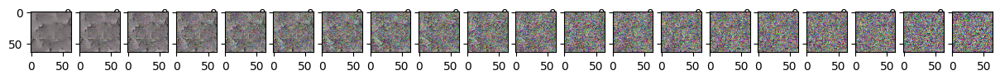

Epoch 30 | step 000 Loss: 0.2137654423713684 


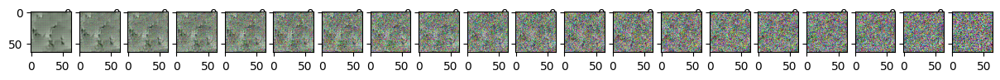

Epoch 35 | step 000 Loss: 0.2137269228696823 


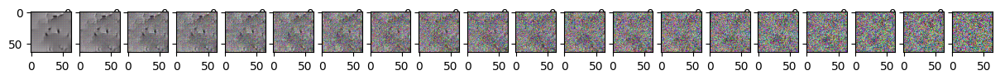

Epoch 40 | step 000 Loss: 0.1963983029127121 


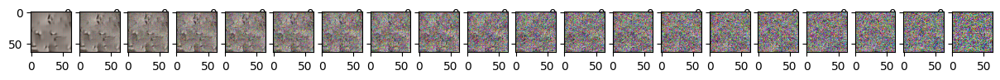

Epoch 45 | step 000 Loss: 0.2057192325592041 


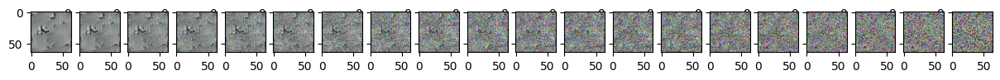

Epoch 50 | step 000 Loss: 0.2201734185218811 


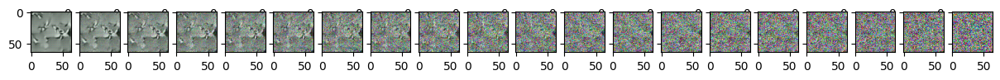

Epoch 55 | step 000 Loss: 0.20892076194286346 


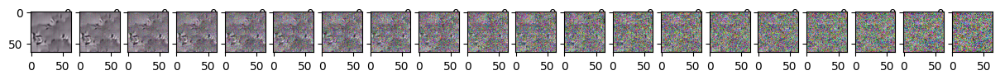

Epoch 60 | step 000 Loss: 0.20802895724773407 


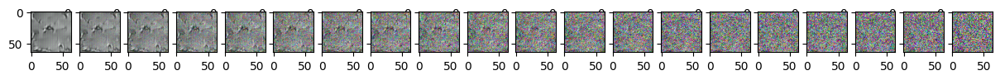

Epoch 65 | step 000 Loss: 0.20344023406505585 


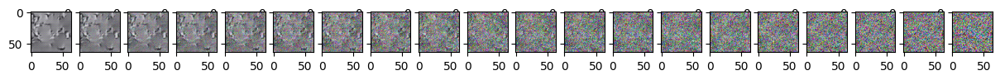

Epoch 70 | step 000 Loss: 0.19908688962459564 


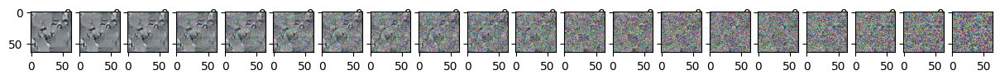

Epoch 75 | step 000 Loss: 0.20352403819561005 


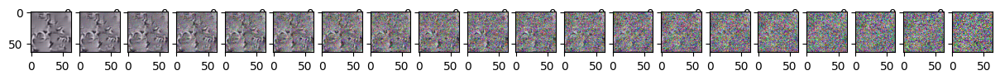

Epoch 80 | step 000 Loss: 0.19513575732707977 


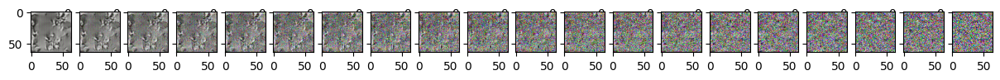

Epoch 85 | step 000 Loss: 0.19991366565227509 


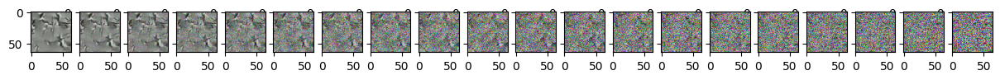

Epoch 90 | step 000 Loss: 0.18789027631282806 


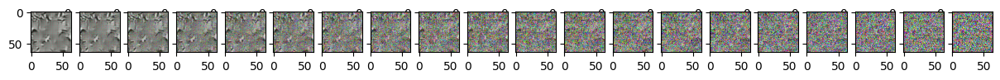

Epoch 95 | step 000 Loss: 0.19541871547698975 


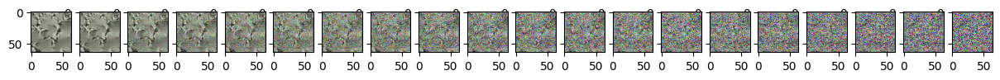

Epoch 100 | step 000 Loss: 0.1785370111465454 


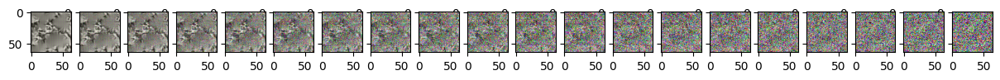

Epoch 105 | step 000 Loss: 0.18285851180553436 


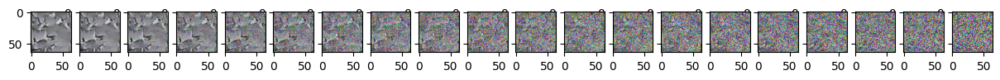

Epoch 110 | step 000 Loss: 0.1894383728504181 


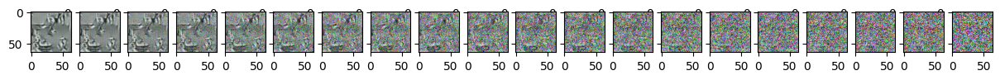

Epoch 115 | step 000 Loss: 0.1821906864643097 


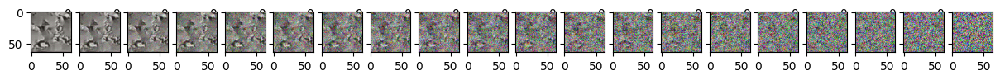

Epoch 120 | step 000 Loss: 0.2105334997177124 


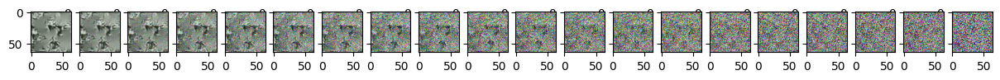

Epoch 125 | step 000 Loss: 0.1837301254272461 


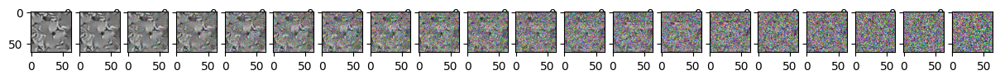

Epoch 130 | step 000 Loss: 0.18775784969329834 


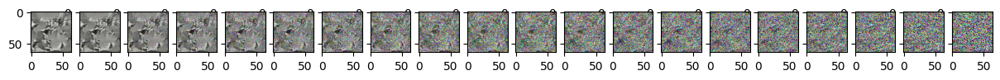

Epoch 135 | step 000 Loss: 0.2180376499891281 


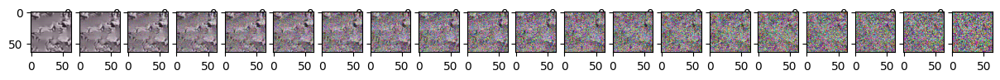

Epoch 140 | step 000 Loss: 0.1918681114912033 


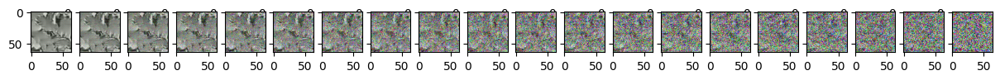

Epoch 145 | step 000 Loss: 0.1836213767528534 


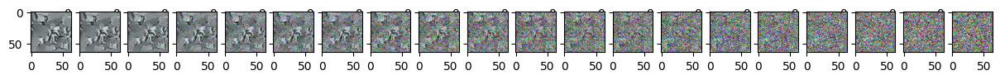

Epoch 150 | step 000 Loss: 0.19504974782466888 


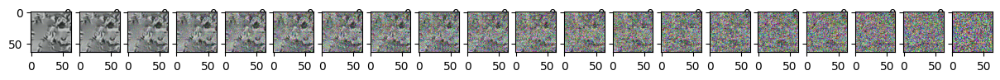

Epoch 155 | step 000 Loss: 0.1784498542547226 


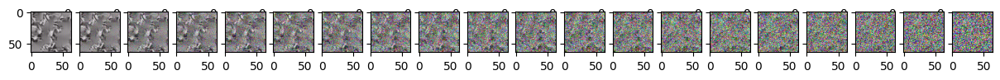

Epoch 160 | step 000 Loss: 0.18388985097408295 


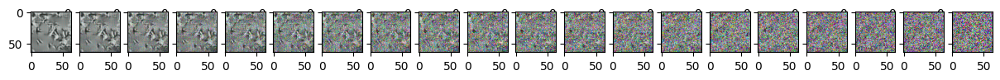

Epoch 165 | step 000 Loss: 0.1921541392803192 


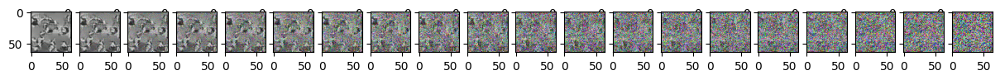

Epoch 170 | step 000 Loss: 0.19154930114746094 


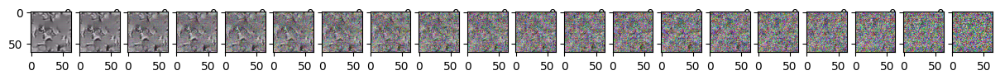

Epoch 175 | step 000 Loss: 0.20304211974143982 


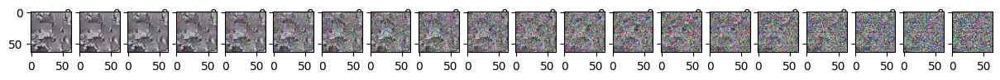

Epoch 180 | step 000 Loss: 0.1967335343360901 


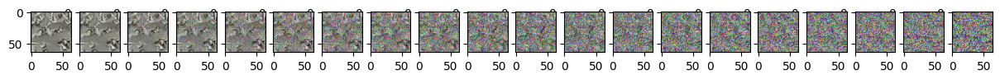

Epoch 185 | step 000 Loss: 0.18759772181510925 


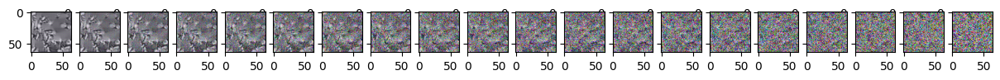

Epoch 190 | step 000 Loss: 0.186992347240448 


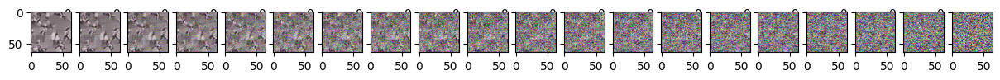

Epoch 195 | step 000 Loss: 0.1952628195285797 


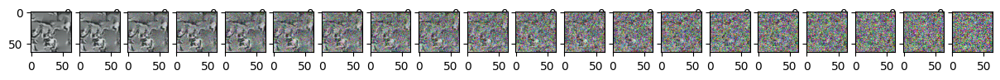

Epoch 200 | step 000 Loss: 0.17660795152187347 


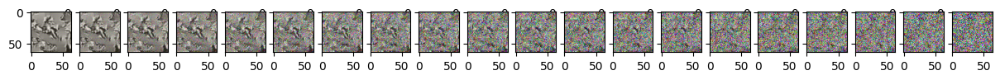

Epoch 205 | step 000 Loss: 0.20162221789360046 


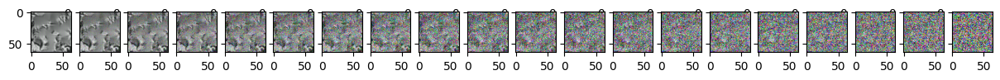

Epoch 210 | step 000 Loss: 0.2112552970647812 


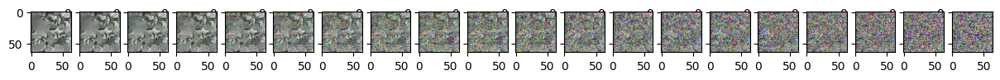

Epoch 215 | step 000 Loss: 0.19684027135372162 


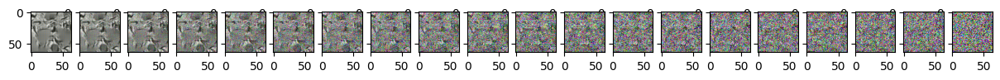

Epoch 220 | step 000 Loss: 0.18693482875823975 


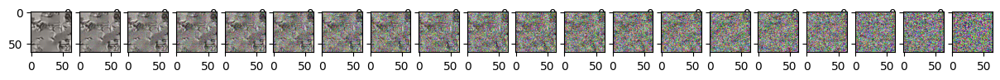

Epoch 225 | step 000 Loss: 0.1992494910955429 


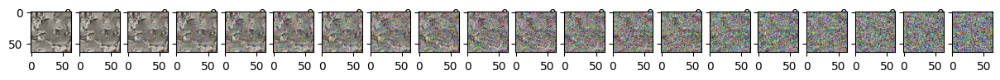

Epoch 230 | step 000 Loss: 0.1855049580335617 


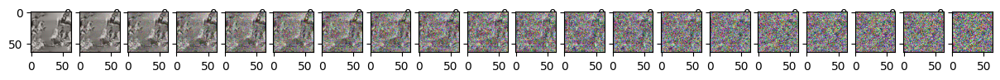

Epoch 235 | step 000 Loss: 0.1982617825269699 


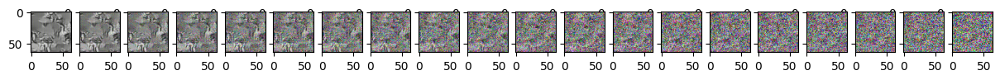

Epoch 240 | step 000 Loss: 0.19050437211990356 


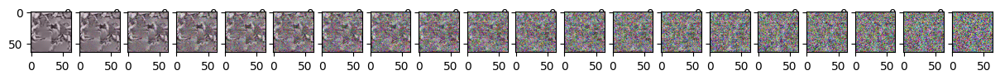

Epoch 245 | step 000 Loss: 0.20604050159454346 


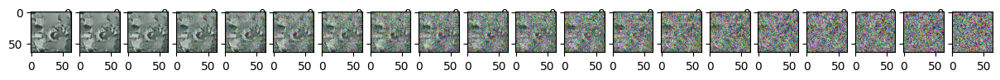

Epoch 250 | step 000 Loss: 0.19544777274131775 


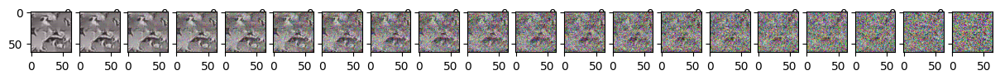

Epoch 255 | step 000 Loss: 0.18718211352825165 


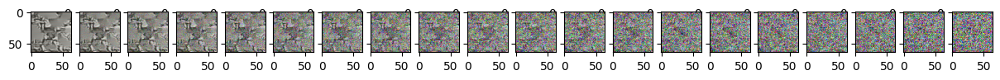

Epoch 260 | step 000 Loss: 0.17222706973552704 


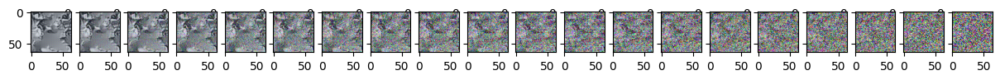

Epoch 265 | step 000 Loss: 0.17448952794075012 


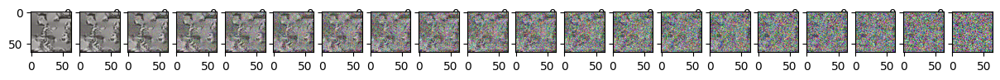

Epoch 270 | step 000 Loss: 0.18490374088287354 


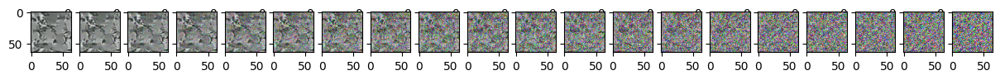

Epoch 275 | step 000 Loss: 0.19070017337799072 


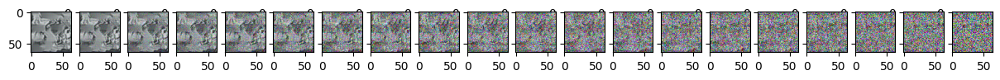

Epoch 280 | step 000 Loss: 0.18599246442317963 


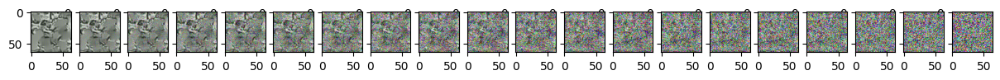

Epoch 285 | step 000 Loss: 0.19072002172470093 


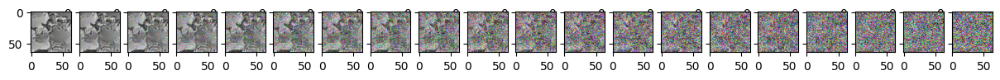

Epoch 290 | step 000 Loss: 0.17805325984954834 


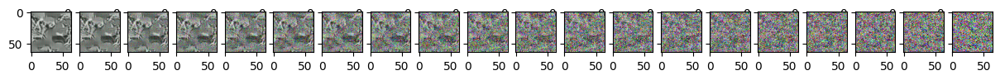

Epoch 295 | step 000 Loss: 0.18267381191253662 


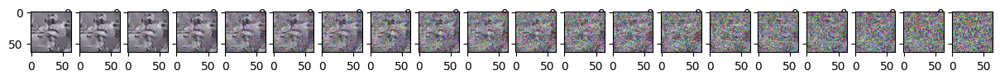

Epoch 300 | step 000 Loss: 0.16690728068351746 


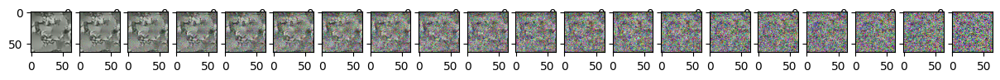

Epoch 305 | step 000 Loss: 0.18845516443252563 


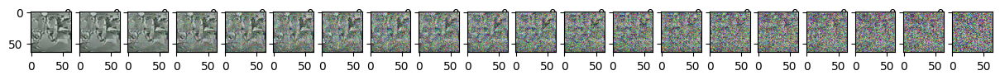

Epoch 310 | step 000 Loss: 0.18344222009181976 


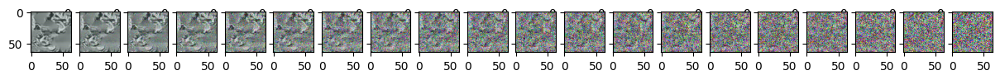

Epoch 315 | step 000 Loss: 0.17507505416870117 


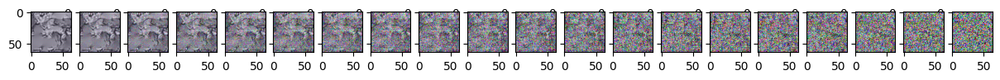

Epoch 320 | step 000 Loss: 0.19474075734615326 


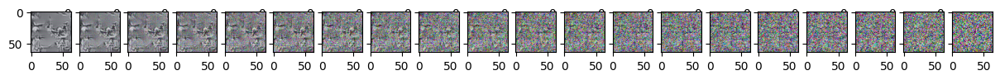

Epoch 325 | step 000 Loss: 0.178663969039917 


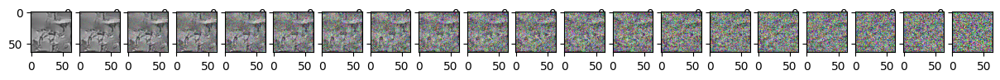

Epoch 330 | step 000 Loss: 0.1870884895324707 


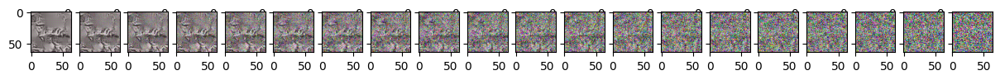

Epoch 335 | step 000 Loss: 0.17529398202896118 


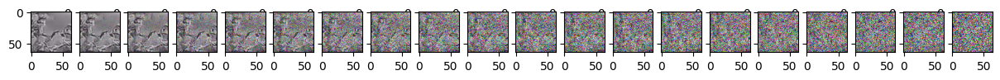

Epoch 340 | step 000 Loss: 0.1770944446325302 


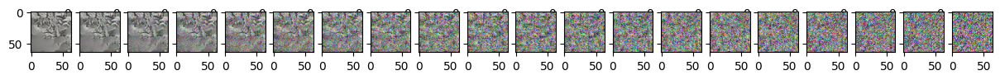

Epoch 345 | step 000 Loss: 0.18716391921043396 


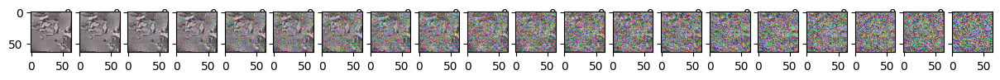

Epoch 350 | step 000 Loss: 0.17202574014663696 


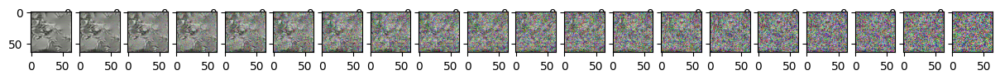

Epoch 355 | step 000 Loss: 0.2003975808620453 


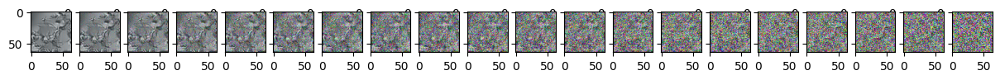

Epoch 360 | step 000 Loss: 0.18011483550071716 


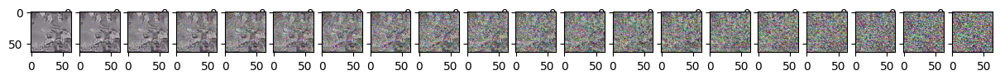

Epoch 365 | step 000 Loss: 0.17735445499420166 


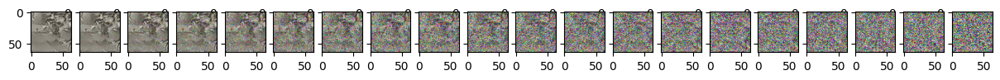

Epoch 370 | step 000 Loss: 0.19313578307628632 


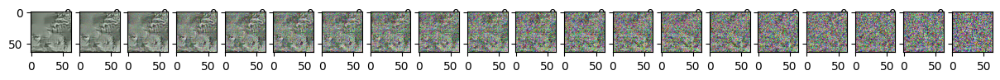

Epoch 375 | step 000 Loss: 0.16632786393165588 


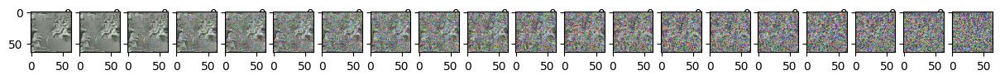

Epoch 380 | step 000 Loss: 0.1691306084394455 


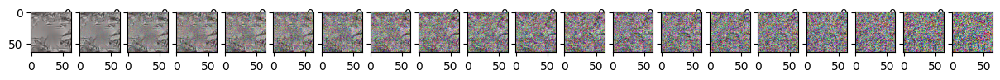

Epoch 385 | step 000 Loss: 0.18365108966827393 


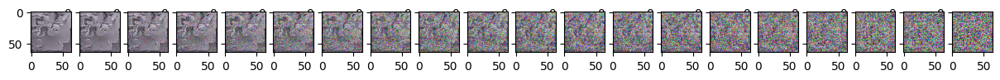

Epoch 390 | step 000 Loss: 0.17712752521038055 


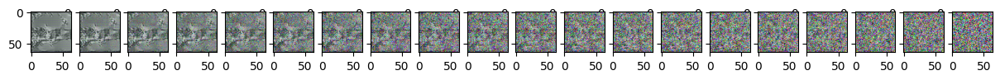

Epoch 395 | step 000 Loss: 0.18098828196525574 


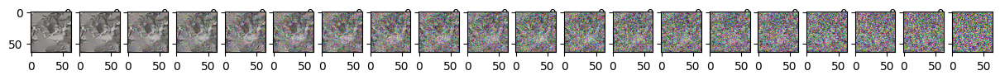

Epoch 400 | step 000 Loss: 0.1692105233669281 


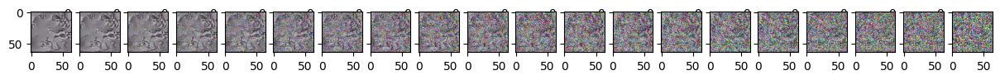

Epoch 405 | step 000 Loss: 0.19184193015098572 


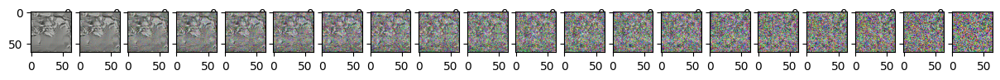

Epoch 410 | step 000 Loss: 0.18086159229278564 


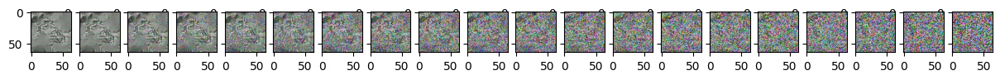

Epoch 415 | step 000 Loss: 0.18582546710968018 


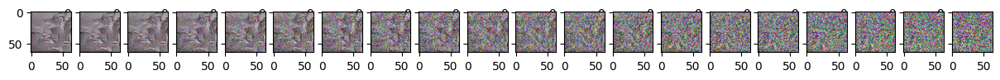

Epoch 420 | step 000 Loss: 0.1744527518749237 


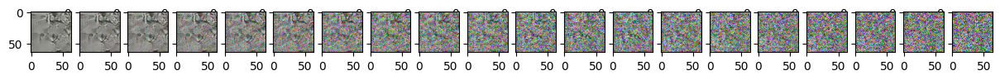

Epoch 425 | step 000 Loss: 0.17990724742412567 


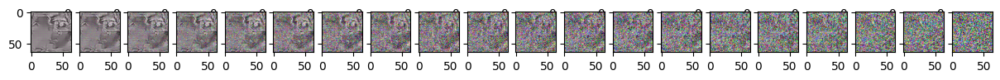

Epoch 430 | step 000 Loss: 0.16558271646499634 


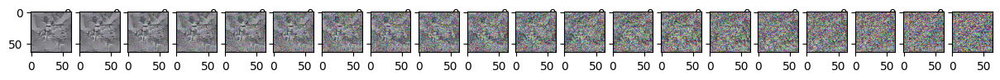

Epoch 435 | step 000 Loss: 0.17387402057647705 


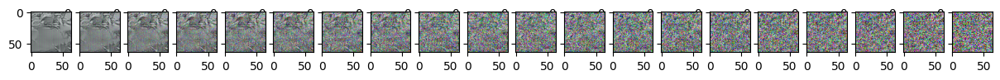

Epoch 440 | step 000 Loss: 0.18200868368148804 


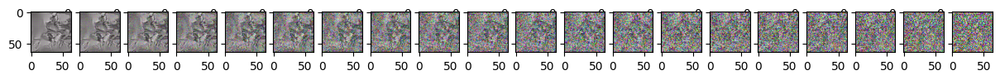

Epoch 445 | step 000 Loss: 0.18604755401611328 


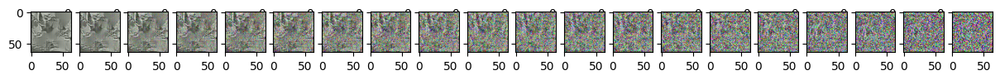

Epoch 450 | step 000 Loss: 0.18596026301383972 


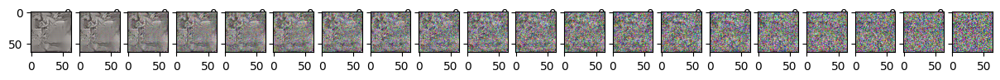

Epoch 455 | step 000 Loss: 0.17105846107006073 


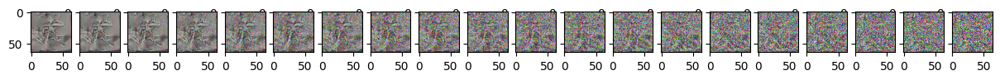

Epoch 460 | step 000 Loss: 0.17696158587932587 


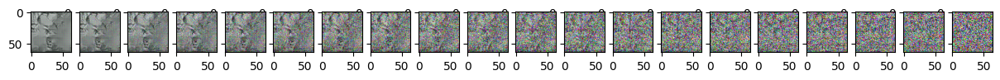

Epoch 465 | step 000 Loss: 0.18753574788570404 


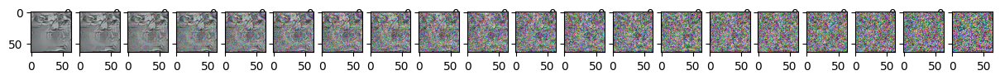

Epoch 470 | step 000 Loss: 0.16124407947063446 


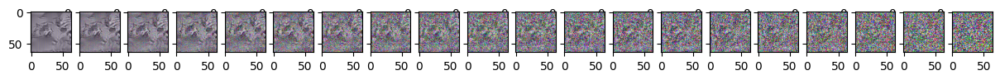

Epoch 475 | step 000 Loss: 0.17729537189006805 


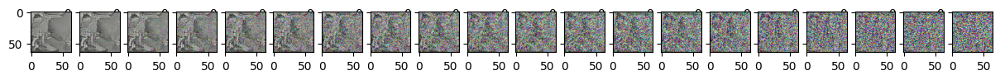

Epoch 480 | step 000 Loss: 0.17468975484371185 


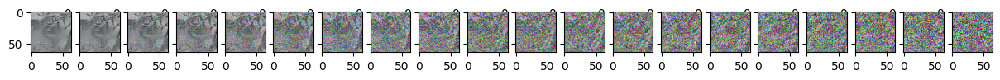

Epoch 485 | step 000 Loss: 0.17980901896953583 


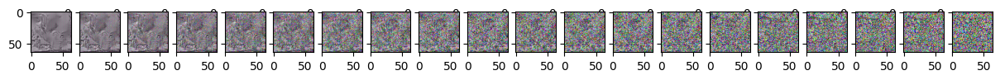

Epoch 490 | step 000 Loss: 0.17924384772777557 


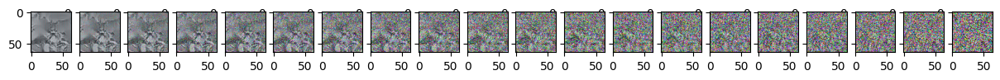

Epoch 495 | step 000 Loss: 0.1845090389251709 


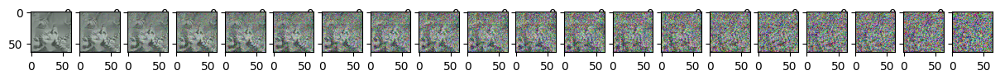

In [24]:
from torch.optim import Adam

if torch.cuda.is_available():
    # Use GPU-related functionality
    device = torch.device('cuda')
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 500 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()

In [25]:
import torch
torch.cuda.is_available()

True